In [1]:
from preprocessing import *
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import re

## Read the Data

In [2]:
from preprocessing import preprocess
data = "./data/data_for_student_case.csv"
df1 = pd.read_csv(data)
df1 = preprocess(df1)

columns = ['issuercountrycode','txvariantcode','bin','amount','currencycode','shoppercountrycode','shopperinteraction','cardverificationcodesupplied','cvcresponsecode','mail_id','accountcode_cc','ip_id','card_id','amount_eur','countries_equal','day_of_week','hour']
X = df1[columns]
Y = df1['simple_journal'].to_numpy(dtype=np.int)

## Heat Maps

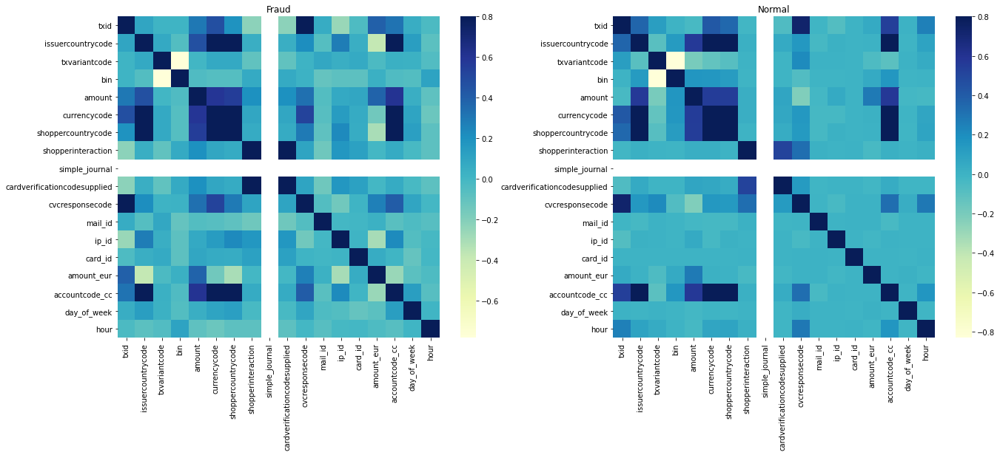

In [3]:
#correlation matrices
f, (ax1, ax2) = plt.subplots(1,2,figsize =(22, 8))

sns.heatmap(df1.query('simple_journal==1').corr(), vmax = .8, square=True, ax = ax1, cmap = 'YlGnBu')
ax1.set_title('Fraud')

sns.heatmap(df1.query('simple_journal==0').corr(), vmax = .8, square=True, ax = ax2, cmap = 'YlGnBu');
ax2.set_title('Normal')

plt.show()



# Sharwin's Work

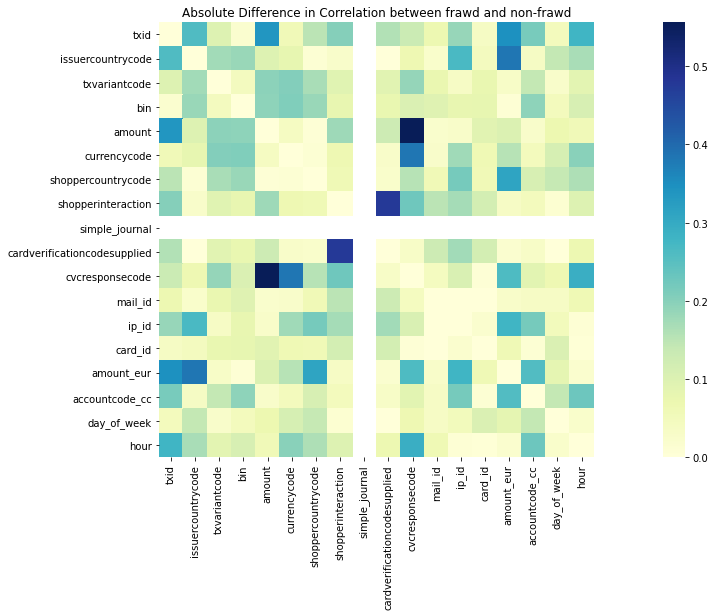

In [4]:
f, (ax1) = plt.subplots(1,figsize =(25, 8))
abs_diff_in_corr = np.abs(df1.query('simple_journal==0').corr() - df1.query('simple_journal==1').corr())
# print(abs_diff_in_corr)
sns.heatmap(abs_diff_in_corr, square=True, cmap = 'YlGnBu')
ax1.set_title('Absolute Difference in Correlation between frawd and non-frawd')
plt.show() 


## Isomap

In [5]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE, Isomap
from sklearn.decomposition import PCA
import numpy as np

(237036, 2)


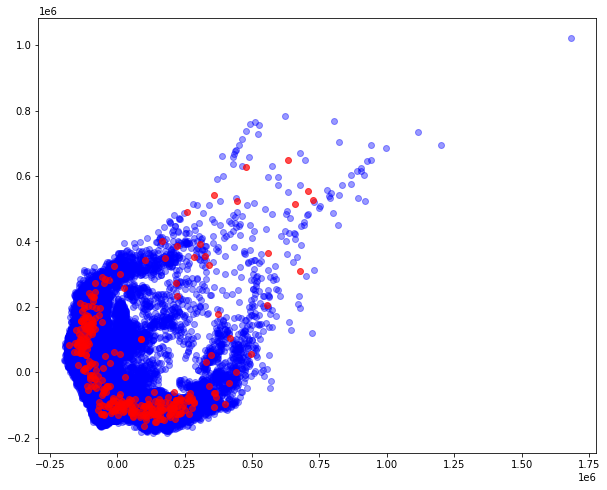

In [10]:
HAVE_MORE_THAN_10Gb_RAM = True

undersampling = 0.001   # 0.1% of non-frawd sampled
if HAVE_MORE_THAN_10Gb_RAM:
    undersampling = 0.01    # 1% of non-frawd sampled
frawd_index = np.where(df1['simple_journal'] == 1)[0]

not_frawd_index = np.where(df1['simple_journal'] == 0)[0]
not_frawd_index = np.random.choice(not_frawd_index, size= int (undersampling*len(not_frawd_index)), replace=False)

isomap = Isomap(n_components=2, n_jobs=-1, neighbors_algorithm='kd_tree', n_neighbors=7, max_iter=1000)
isomap.fit(X.iloc[np.union1d(frawd_index, not_frawd_index),:])
X_embedded = isomap.transform(X)
print(X_embedded.shape)

fig = plt.figure(figsize=(10,8))

frawd_index = np.where(df1['simple_journal'] == 1)[0]
not_frawd_index = np.where(df1['simple_journal'] == 0)[0]

plt.scatter(X_embedded[not_frawd_index, 0], X_embedded[not_frawd_index, 1], c='b', alpha=0.4)
plt.scatter(X_embedded[frawd_index, 0], X_embedded[frawd_index, 1], c='r', alpha=0.7)

plt.show()

## PCA: Shows very obscured view
Lets subsample the majority class for displaying 

In [2]:
X_embedded = PCA(n_components=2).fit_transform(X)
frawd_index = np.where(df1['simple_journal'] == 1)[0]

not_frawd_index = np.where(df1['simple_journal'] == 0)[0]
not_frawd_index = np.random.choice(not_frawd_index, size= int (0.1*len(not_frawd_index)), replace=False)

fig = plt.figure(figsize=(10,8))
plt.scatter(X_embedded[not_frawd_index, 0], X_embedded[not_frawd_index, 1], c='b', alpha=0.4)
plt.scatter(X_embedded[frawd_index, 0], X_embedded[frawd_index, 1], c='r')
plt.show()

NameError: name 'PCA' is not defined

,issuercountrycode,txvariantcode,bin,amount,currencycode,shoppercountrycode,shopperinteraction,cardverificationcodesupplied,cvcresponsecode,accountcode,mail_id,ip_id,card_id,amount_eur,countries_equal,day_of_week,hour
0,104,2,530056.0,64800.0,2,104,1,1,0,1,187702,7386,73358,30.446979,1,2,23
1,104,2,547046.0,44900.0,2,104,1,1,0,1,834,194109,44739,21.096749,1,3,4
2,104,2,528843.0,149900.0,2,104,1,1,0,1,119287,189655,122802,70.432131,1,3,14
3,104,2,547146.0,109900.0,2,104,1,1,0,1,173561,8254,70712,51.637700,1,4,7
4,104,6,477291.0,89900.0,2,104,1,1,0,1,70647,196247,208481,42.240484,1,2,18
